# Programming Project #1: Hybrid Images

## CS445: Computational Photography

### Part I: Hybrid Images

In [1]:
import cv2
import sys
import numpy as np
from matplotlib.colors import LogNorm
from scipy import signal
from utils.utils import *
from utils.display import display_filtering_process

In [2]:
# switch from notebook to inline if using colab or otherwise cannot use interactive display)
%matplotlib notebook
import matplotlib.pyplot as plt

In [3]:
im1_file = 'me.jpg'
im2_file = 'misha_small.jpg'

im1 = np.float32(cv2.imread(im1_file, cv2.IMREAD_GRAYSCALE) / 255.0)
im2 = np.float32(cv2.imread(im2_file, cv2.IMREAD_GRAYSCALE) / 255.0)

<IPython.core.display.Javascript object>


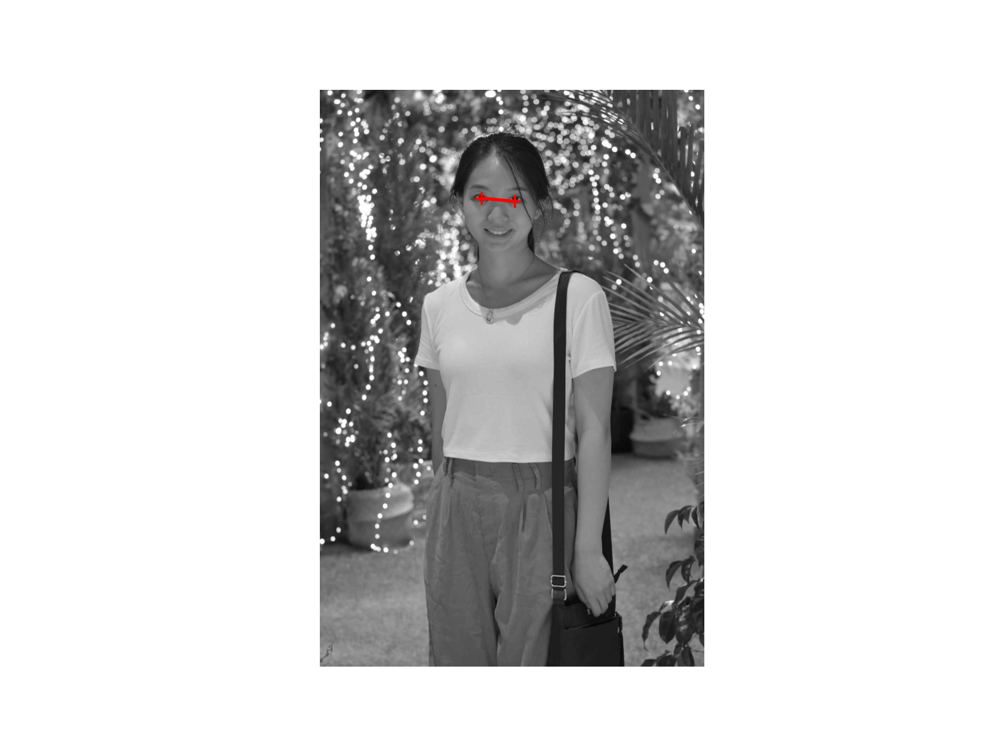

In [7]:
pts_im1 = prompt_eye_selection(im1)
# pts_im1 = np.array([[642, 753], [757, 764]]) # uncomment if entering [x, y] pts manually
# plt.plot(pts_im1[:,0], pts_im1[:,1], 'r-+')

<IPython.core.display.Javascript object>


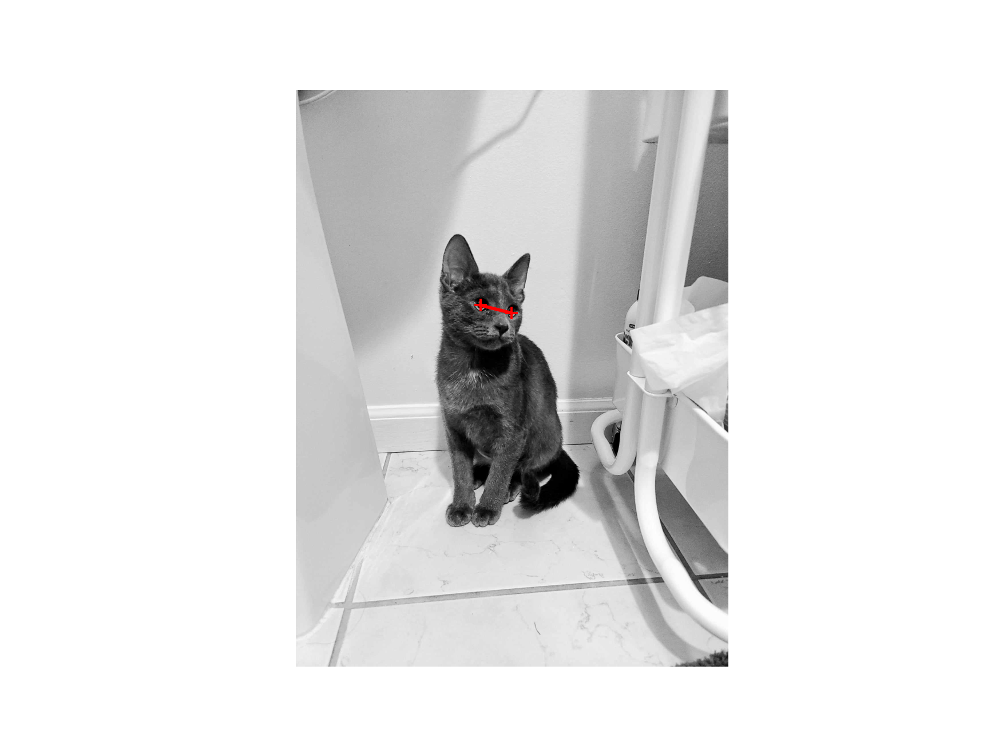

In [8]:
pts_im2 = prompt_eye_selection(im2)
# pts_im2 = np.array([[470,607], [573,675]]) # uncomment if entering [x, y] pts manually
# plt.plot(pts_im2[:,0], pts_im2[:,1], 'r-+')

In [9]:
im1, im2 = align_images(im1_file, im2_file,pts_im1,pts_im2,save_images=False)

In [10]:
# convert to grayscale
im1 = cv2.cvtColor(im1, cv2.COLOR_BGR2GRAY) / 255.0
im2 = cv2.cvtColor(im2, cv2.COLOR_BGR2GRAY) / 255.0

<IPython.core.display.Javascript object>


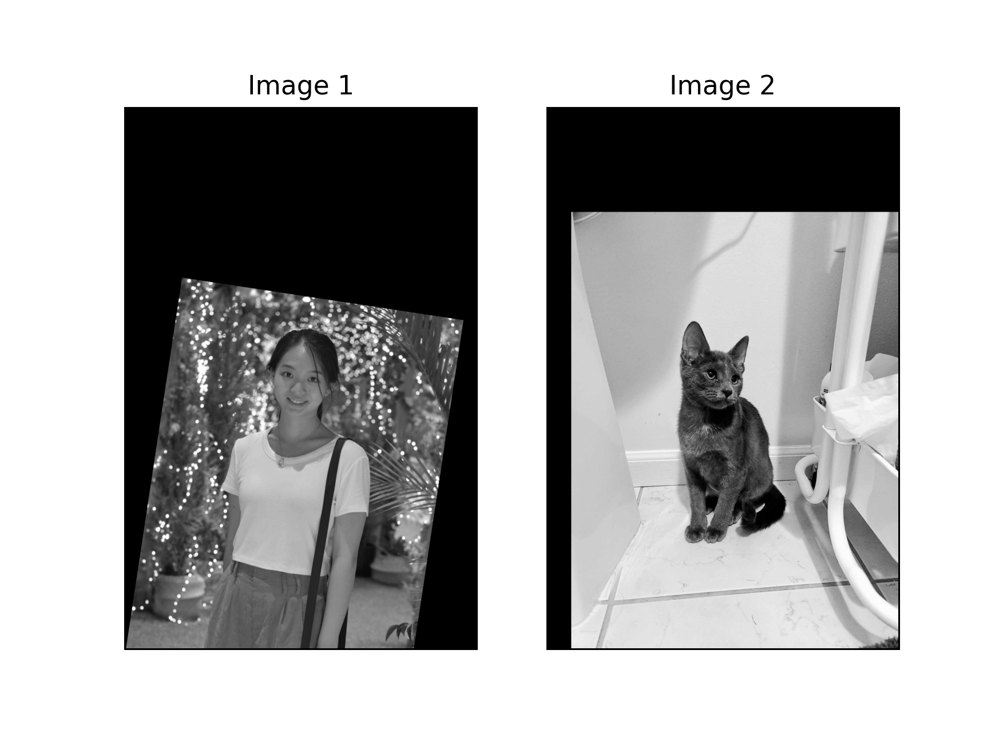

(2055, 1335) (2055, 1335)


In [11]:
#Images sanity check
fig, axes = plt.subplots(1, 2)
axes[0].imshow(im1,cmap='gray')
axes[0].set_title('Image 1'), axes[0].set_xticks([]), axes[0].set_yticks([])
axes[1].imshow(im2,cmap='gray')
axes[1].set_title('Image 2'), axes[1].set_xticks([]), axes[1].set_yticks([]);
print(im1.shape, im2.shape)

<IPython.core.display.Javascript object>


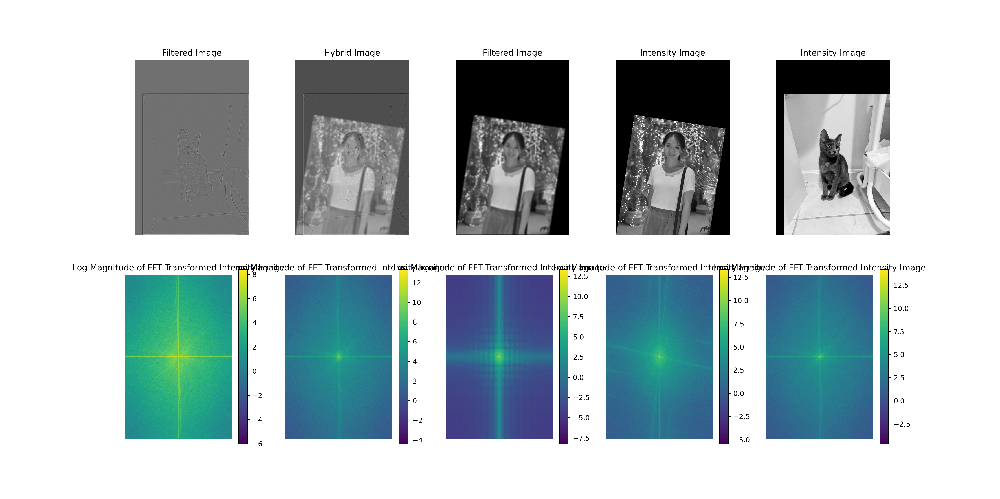

In [14]:
sigma_low = 10
sigma_high = 5

im_hybrid = hybridImage(im1, im2, sigma_low, sigma_high)

<IPython.core.display.Javascript object>


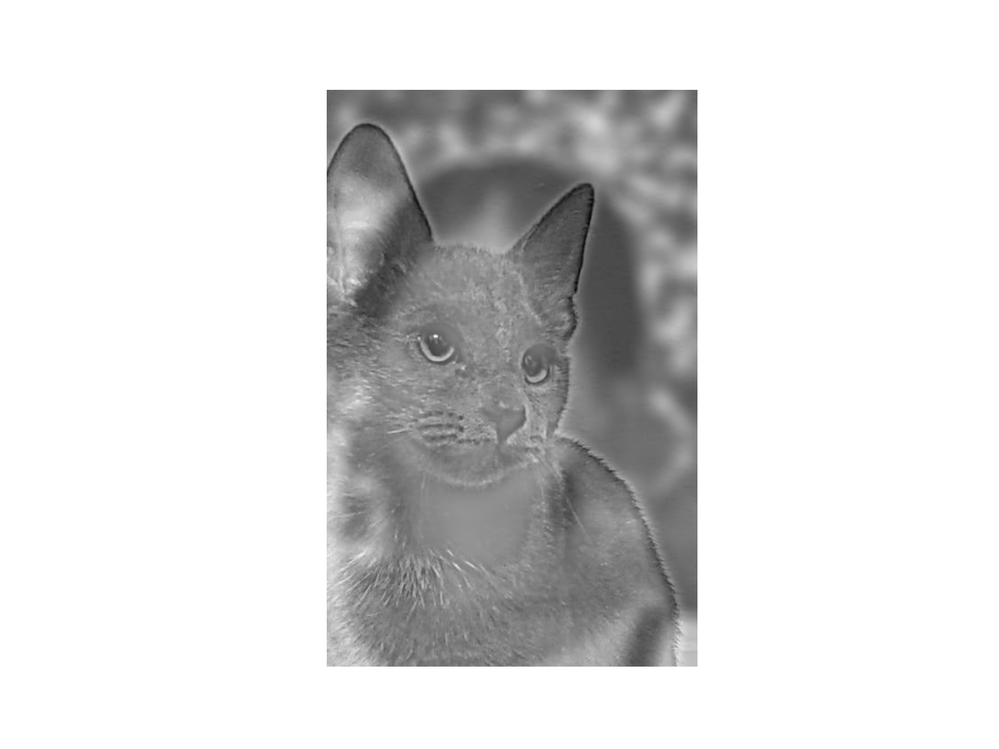

In [81]:
cropped_object = interactive_crop(im_hybrid)

In [90]:
main_hybrid = cropped_object['cropped_image']

#### Kyoto Skytree

In [4]:
im1_file = 'kyoto_tower.jpg'
im2_file = 'skytree.jpg'

im1 = np.float32(cv2.imread(im1_file, cv2.IMREAD_GRAYSCALE) / 255.0)
im2 = np.float32(cv2.imread(im2_file, cv2.IMREAD_GRAYSCALE) / 255.0)

<IPython.core.display.Javascript object>


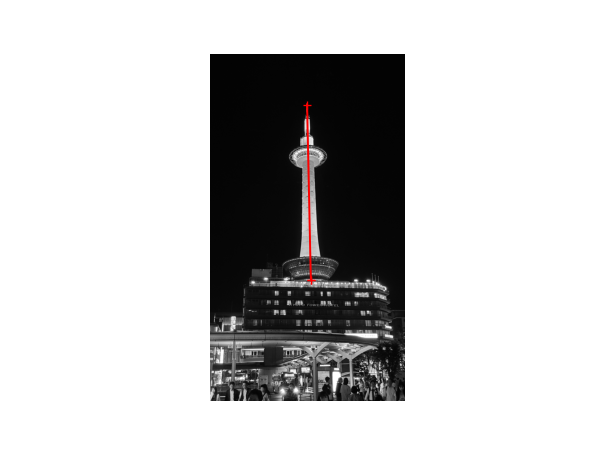

In [5]:
pts_im1 = prompt_eye_selection(im1)
# pts_im1 = np.array([[642, 753], [757, 764]]) # uncomment if entering [x, y] pts manually
# plt.plot(pts_im1[:,0], pts_im1[:,1], 'r-+')

<IPython.core.display.Javascript object>


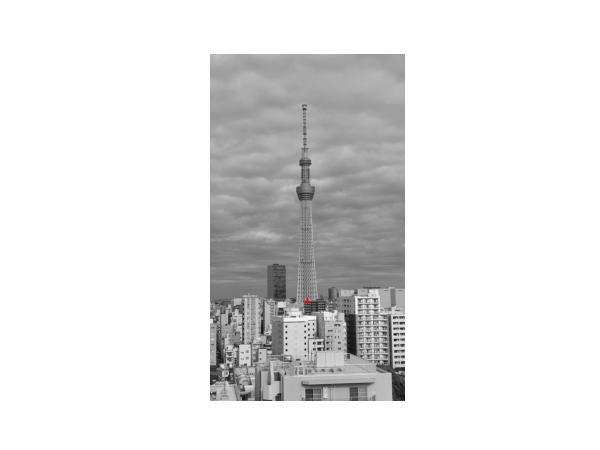

In [6]:
pts_im2 = prompt_eye_selection(im2)
# pts_im2 = np.array([[470,607], [573,675]]) # uncomment if entering [x, y] pts manually
# plt.plot(pts_im2[:,0], pts_im2[:,1], 'r-+')

In [7]:
im1, im2 = align_images(im1_file, im2_file,pts_im1,pts_im2,save_images=False)

In [8]:
# convert to grayscale
im1 = cv2.cvtColor(im1, cv2.COLOR_BGR2GRAY) / 255.0
im2 = cv2.cvtColor(im2, cv2.COLOR_BGR2GRAY) / 255.0

<IPython.core.display.Javascript object>


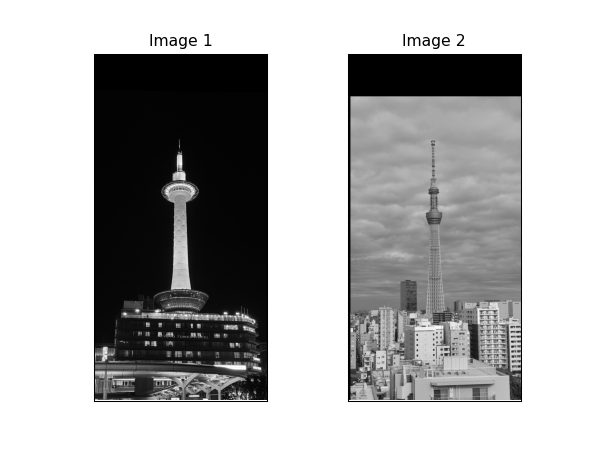

(4122, 2058) (4122, 2058)


In [9]:
#Images sanity check
fig, axes = plt.subplots(1, 2)
axes[0].imshow(im1,cmap='gray')
axes[0].set_title('Image 1'), axes[0].set_xticks([]), axes[0].set_yticks([])
axes[1].imshow(im2,cmap='gray')
axes[1].set_title('Image 2'), axes[1].set_xticks([]), axes[1].set_yticks([]);
print(im1.shape, im2.shape)

First, you'll need to get a few pairs of images that you want to make into hybrid images. You can use the sample images for debugging, but you should use your own images in your results. Then, you will need to write code to low-pass filter one image, high-pass filter the second image, and add (or average) the two images. For a low-pass filter, Oliva et al. suggest using a standard 2D Gaussian filter. For a high-pass filter, they suggest using the impulse filter minus the Gaussian filter (which can be computed by subtracting the Gaussian-filtered image from the original). The cutoff-frequency of each filter should be chosen with some experimentation.

For your favorite result, you should also illustrate the process through frequency analysis. Show the log magnitude of the Fourier transform of the two input images, the filtered images, and the hybrid image. In Python, you can compute and display the 2D Fourier transform using Matplotlib and Numpy with: plt.imshow(numpy.log(numpy.abs(numpy.fft.fftshift(numpy.fft.fft2(gray_image)))))

Try creating a variety of types of hybrid images (change of expression, morph between different objects, change over time, etc.). The site has several examples that may inspire.

In [13]:
def hybridImage(im1, im2, sigma_low, sigma_high):
    '''
    Inputs:
        im1:    RGB (height x width x 3) or a grayscale (height x width) image
                as a numpy array.
        im2:    RGB (height x width x 3) or a grayscale (height x width) image
                as a numpy array.
        sigma_low: standard deviation for the low-pass filter
        sigma_high: standard deviation for the high-pass filter
        
    Output:
        Return the combination of both images, one filtered with a low-pass filter
        and the other with a high-pass filter.
    '''  
    H, W = im1.shape
    # for linear normalization when plotting fft images
    vmin, vmax = None, None
    
    def _to_log_amplitude(frequency_image):
        # adapted from demo utils.display to convert freq image to log amplitude image 
        shifted_image = np.fft.fftshift(frequency_image)
        amplitude_image = np.abs(shifted_image + sys.float_info.epsilon)
        log_amplitude_image = np.log(amplitude_image)
        return log_amplitude_image
    
    def gaussian_filtered(im, sigma):
        # create 2d gaussian filtered image with standard deviation from trial and error
        gaussian_kernel1d = signal.gaussian(21, sigma)[:, np.newaxis]
        kernel = np.outer(gaussian_kernel1d, gaussian_kernel1d)
        gaussian_kernel = kernel / kernel.sum()
        
        hs = gaussian_kernel.shape[0] // 2 
        fftsize = 4096
        im_fft = np.fft.fft2(im, (fftsize, fftsize))
        fil_fft = np.fft.fft2(gaussian_kernel, (fftsize, fftsize))
        im_fil_fft = im_fft * fil_fft
        im_fil = np.fft.ifft2(im_fil_fft)
        im_fil = im_fil[hs:hs + H, hs:hs + W]
        im_fil = np.real(im_fil)
        
        intensity_image = im
        filter_image = np.pad(gaussian_kernel, 1, 'constant', constant_values=(0))
        fft_intensity_log_amplitude = _to_log_amplitude(im_fft)
        fft_filtered_log_amplitude = _to_log_amplitude(im_fil_fft)
        fft_kernel_amplitude = np.abs(np.fft.fftshift(fil_fft) + sys.float_info.epsilon)
    
    
        sv = np.sort(fft_intensity_log_amplitude.flatten())

        vmin = sv[int(round(len(sv) * 0.005))]
        vmax = sv[-1]
        
        return im_fil

    # low pass: gaussian
    filtered_im1 = gaussian_filtered(im1, sigma_low)
    
    # high pass: impulse filter minus the Gaussian filter
    # which can be computed by subtracting the Gaussian-filtered image from the original
    im2.resize(filtered_im1.shape, refcheck=False)
    filtered_im2 = im2 - gaussian_filtered(im2, sigma_high)
    
#     plot original, filtered, FFT images (commented out when running additional results)
    fig, axes = plt.subplots(2, 5, figsize=(20, 10))
    [a.axis('off') for a in axes.ravel()]
    axes[0, 0].set_title('Filtered Image')
    axes[0, 0].imshow(filtered_im2, cmap='gray')

    axes[1, 0].set_title('Log Magnitude of FFT Transformed Intensity Image')
    ax10 = axes[1, 0].imshow(np.log(np.abs(np.fft.fftshift(np.fft.fft2(filtered_im2)))), vmin=vmin, vmax=vmax)
    fig.colorbar(ax10, ax=axes[1, 0])

    axes[0, 1].set_title('Hybrid Image')
    axes[0, 1].imshow(filtered_im1 + filtered_im2, cmap='gray')

    axes[1, 1].set_title('Log Magnitude of FFT Transformed Intensity Image')
    ax11 = axes[1, 1].imshow(np.log(np.abs(np.fft.fftshift(np.fft.fft2(filtered_im1 + filtered_im2)))), vmin=vmin, vmax=vmax)
    fig.colorbar(ax11, ax=axes[1, 1])
    
    axes[0, 2].set_title('Filtered Image')
    axes[0, 2].imshow(filtered_im1, cmap='gray')

    axes[1, 2].set_title('Log Magnitude of FFT Transformed Intensity Image')
    ax12 = axes[1, 2].imshow(np.log(np.abs(np.fft.fftshift(np.fft.fft2(filtered_im1)))), vmin=vmin, vmax=vmax)
    fig.colorbar(ax12, ax=axes[1, 2])
    
    axes[0, 3].set_title('Intensity Image')
    axes[0, 3].imshow(im1, cmap='gray')

    axes[1, 3].set_title('Log Magnitude of FFT Transformed Intensity Image')
    ax13 = axes[1, 3].imshow(np.log(np.abs(np.fft.fftshift(np.fft.fft2(im1)))), vmin=vmin, vmax=vmax)
    fig.colorbar(ax13, ax=axes[1, 3])
    
    axes[0, 4].set_title('Intensity Image')
    axes[0, 4].imshow(im2, cmap='gray')

    axes[1, 4].set_title('Log Magnitude of FFT Transformed Intensity Image')
    ax14 = axes[1, 4].imshow(np.log(np.abs(np.fft.fftshift(np.fft.fft2(im2)))), vmin=vmin, vmax=vmax)
    fig.colorbar(ax14, ax=axes[1, 4])

    color_bar_targets = [ax10, ax11, ax12, ax13]
    plt.show()
    
    return filtered_im1 + filtered_im2

Can you see too many details in the low pass when you are up close?  Then, perhaps increase sigma_low (this will remove detail).  Can you see the high pass too easily when you are far away?  Then decrease sigma_high (this will blur less and then when result is subtracted from original will remove more mid-frequencies).

<IPython.core.display.Javascript object>


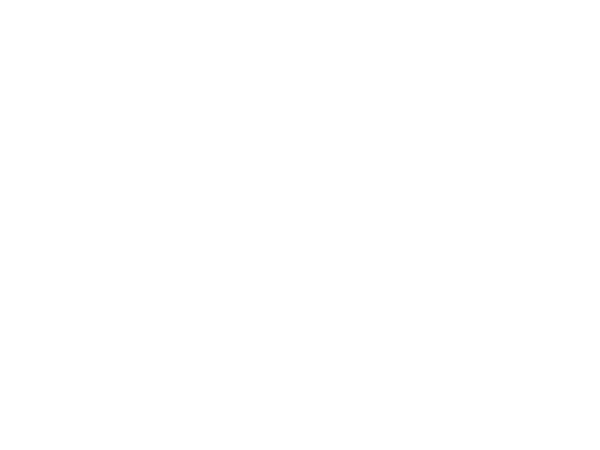

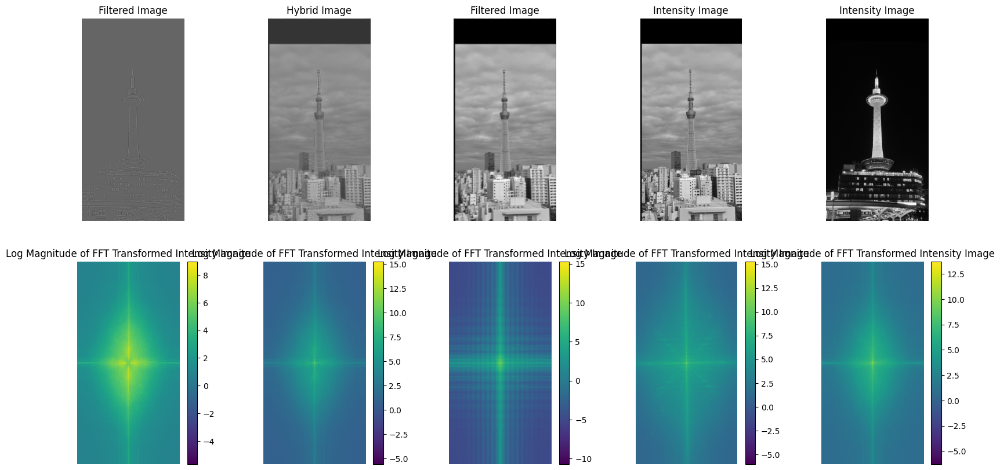

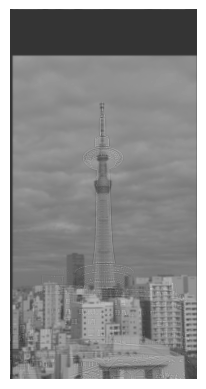

In [11]:
%matplotlib inline
sigma_low = 10
sigma_high = 10

im_hybrid = hybridImage(im2, im1, sigma_low, sigma_high)
cropped_object = interactive_crop(im_hybrid)

#### Saana

In [95]:
%matplotlib notebook
im1_file = 'saana_awake.jpg'
im2_file = 'saana_asleep.jpg'

im1 = np.float32(cv2.imread(im1_file, cv2.IMREAD_GRAYSCALE) / 255.0)
im2 = np.float32(cv2.imread(im2_file, cv2.IMREAD_GRAYSCALE) / 255.0)

<IPython.core.display.Javascript object>


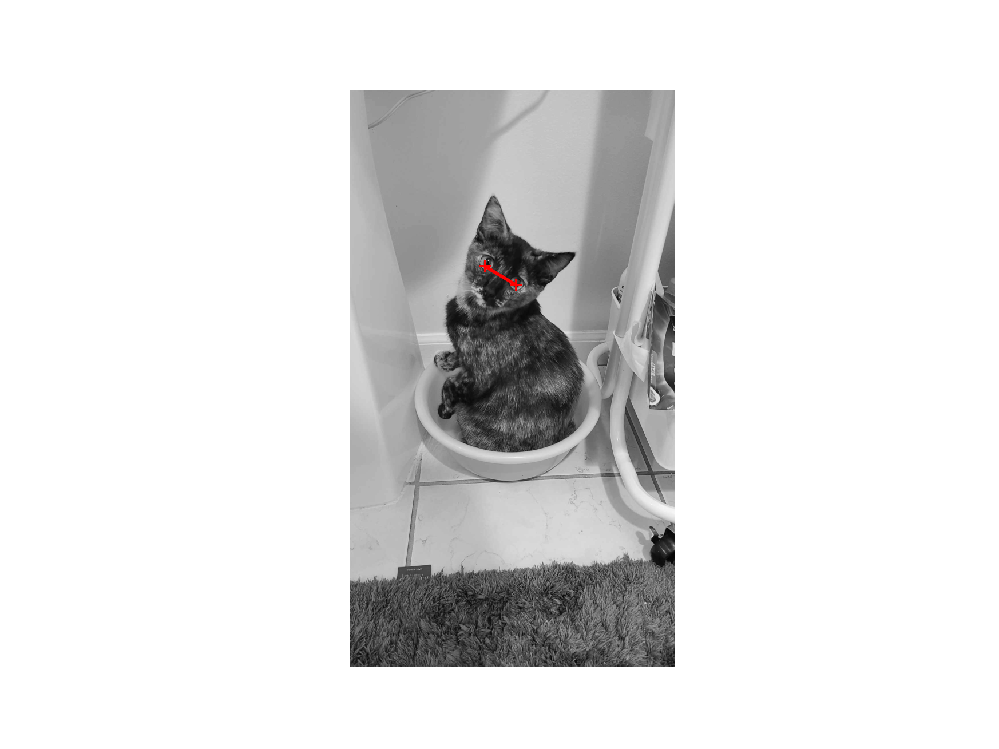

In [97]:
pts_im1 = prompt_eye_selection(im1)
# pts_im1 = np.array([[642, 753], [757, 764]]) # uncomment if entering [x, y] pts manually
# plt.plot(pts_im1[:,0], pts_im1[:,1], 'r-+')

<IPython.core.display.Javascript object>


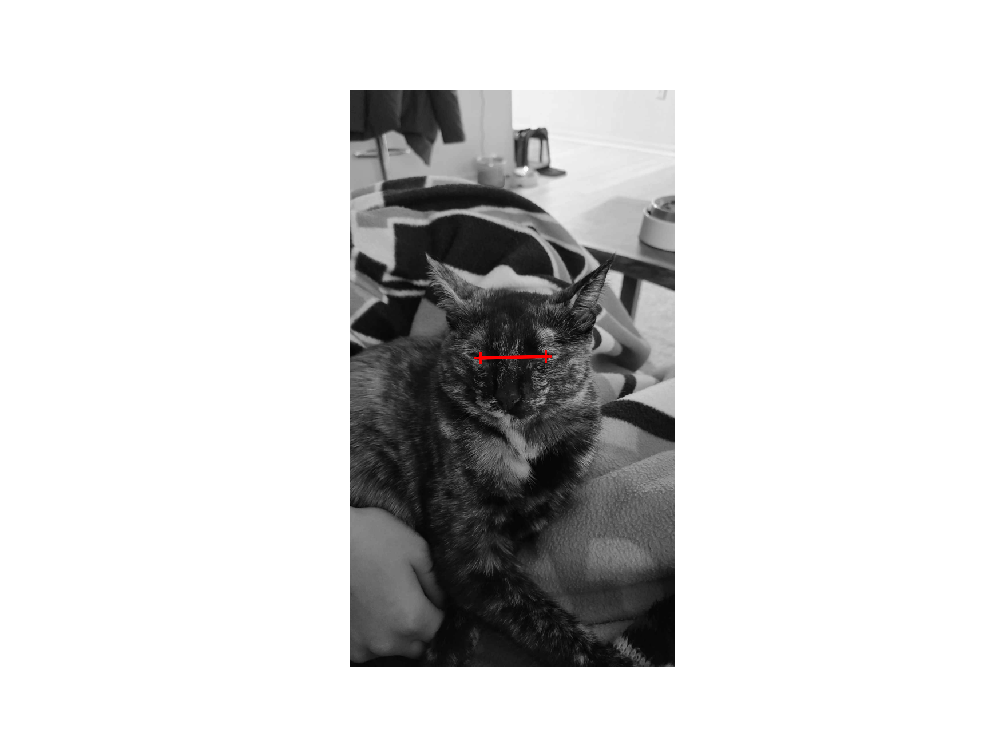

In [98]:
pts_im2 = prompt_eye_selection(im2)
# pts_im2 = np.array([[470,607], [573,675]]) # uncomment if entering [x, y] pts manually
# plt.plot(pts_im2[:,0], pts_im2[:,1], 'r-+')

In [99]:
im1, im2 = align_images(im1_file, im2_file,pts_im1,pts_im2,save_images=False)

In [100]:
# convert to grayscale
im1 = cv2.cvtColor(im1, cv2.COLOR_BGR2GRAY) / 255.0
im2 = cv2.cvtColor(im2, cv2.COLOR_BGR2GRAY) / 255.0

<IPython.core.display.Javascript object>


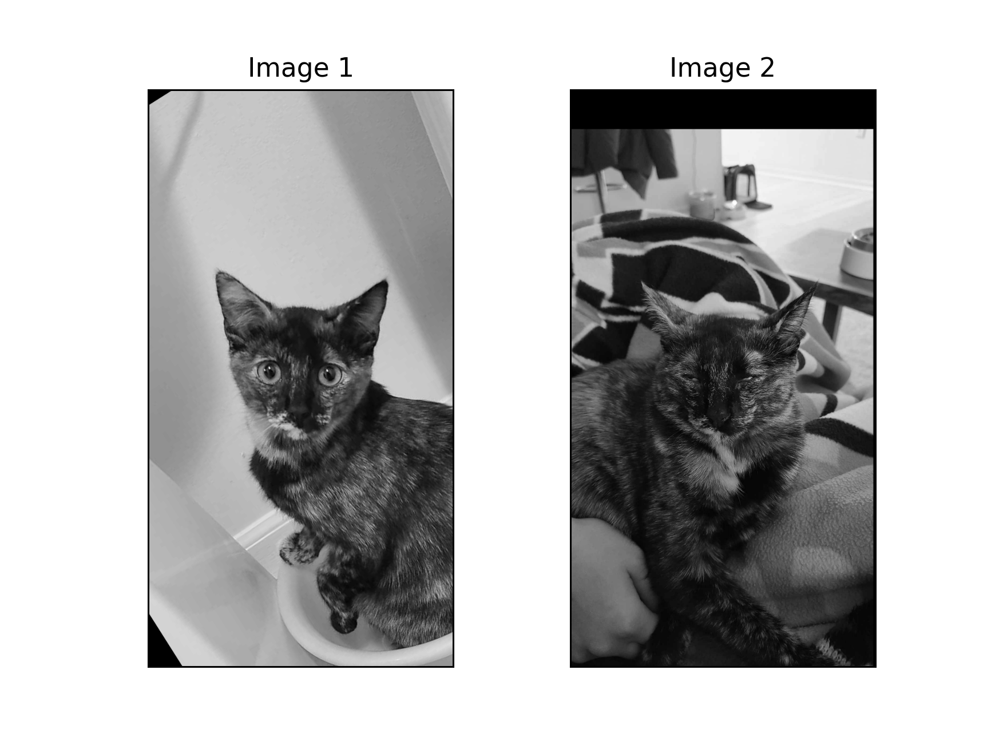

(1200, 634) (1200, 634)


In [101]:
#Images sanity check
fig, axes = plt.subplots(1, 2)
axes[0].imshow(im1,cmap='gray')
axes[0].set_title('Image 1'), axes[0].set_xticks([]), axes[0].set_yticks([])
axes[1].imshow(im2,cmap='gray')
axes[1].set_title('Image 2'), axes[1].set_xticks([]), axes[1].set_yticks([]);
print(im1.shape, im2.shape)

<IPython.core.display.Javascript object>


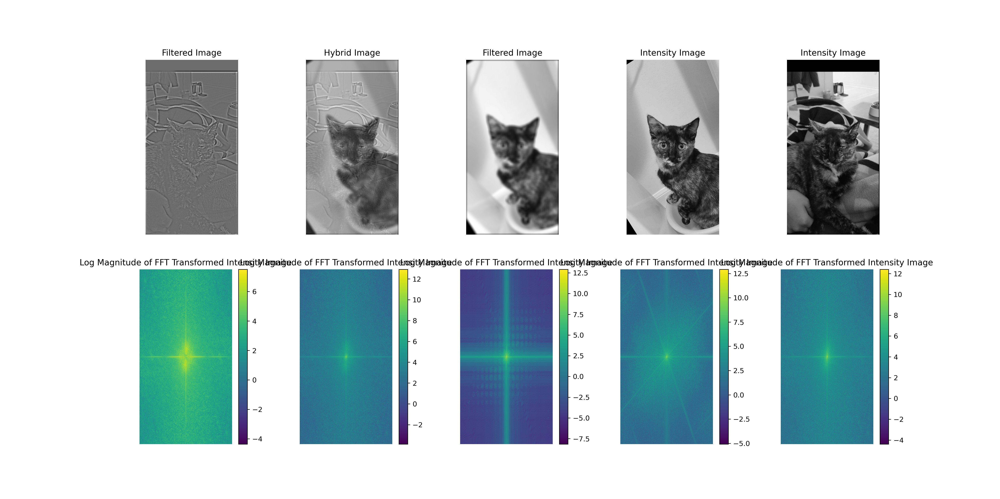

In [120]:
sigma_low = 30
sigma_high = 10

im_hybrid = hybridImage(im1, im2, sigma_low, sigma_high)

<IPython.core.display.Javascript object>


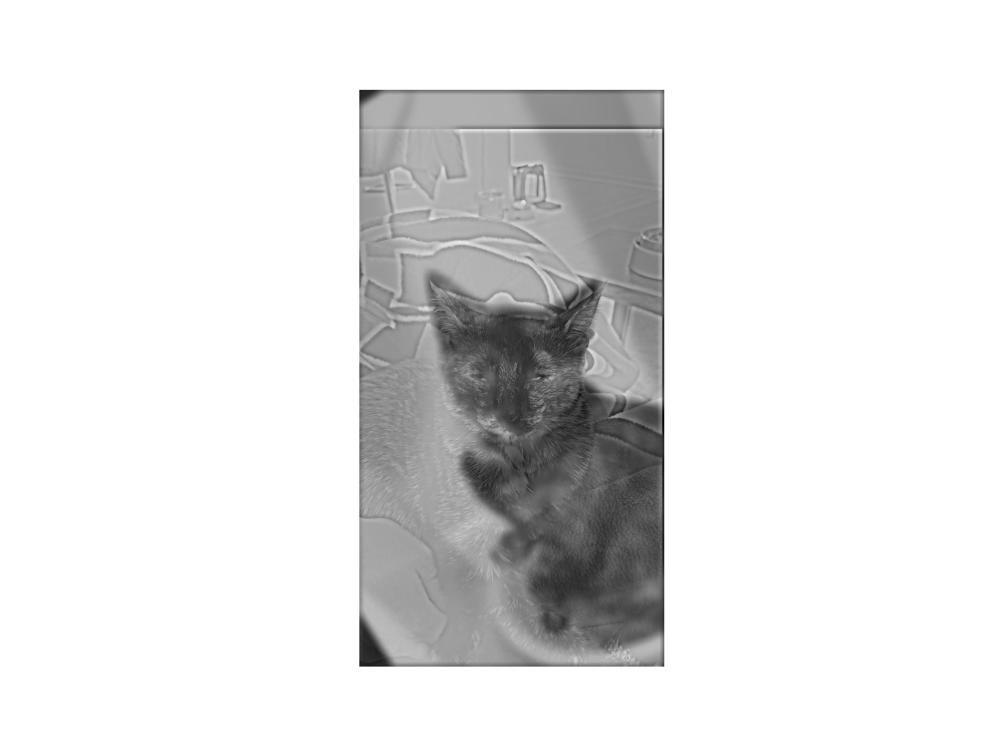

In [121]:
cropped_object = interactive_crop(im_hybrid)

### Part II: Image Enhancement

##### Two out of three types of image enhancement are required.  Choose a good image to showcase each type and implement a method.  This code doesn't rely on the hybrid image part.

#### Contrast Enhancement
###### adaptive histogram equalization 
In this, image is divided into small blocks called "tiles" (tileSize is 8x8 by default in OpenCV). Then each of these blocks are histogram equalized as usual. So in a small area, histogram would confine to a small region (unless there is noise). If noise is there, it will be amplified. To avoid this, contrast limiting is applied. If any histogram bin is above the specified contrast limit (by default 40 in OpenCV), those pixels are clipped and distributed uniformly to other bins before applying histogram equalization. After equalization, to remove artifacts in tile borders, bilinear interpolation is applied.

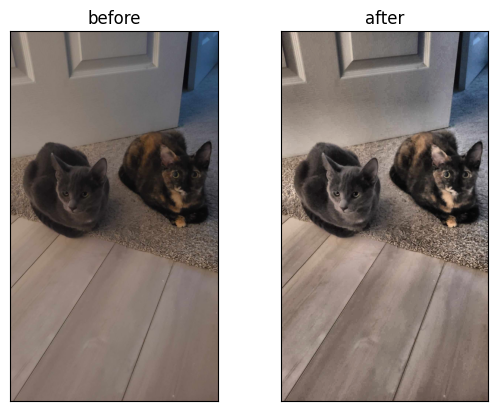

In [11]:
%matplotlib inline
img = cv2.imread('contrast_loaves.jpg')
img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
assert img is not None, "file could not be read, check with os.path.exists()"

# convert to LAB
lab = cv2.cvtColor(img, cv2.COLOR_RGB2LAB)

# create a CLAHE object
clahe = cv2.createCLAHE(clipLimit=2.0, tileGridSize=(8,8))
lab[...,0] = clahe.apply(lab[...,0])

cl1 = cv2.cvtColor(lab, cv2.COLOR_LAB2RGB)

fig, axes = plt.subplots(1, 2)
axes[0].imshow(img,cmap='gray')
axes[0].set_title('before'), axes[0].set_xticks([]), axes[0].set_yticks([])
axes[1].imshow(cl1,cmap='gray')
axes[1].set_title('after'), axes[1].set_xticks([]), axes[1].set_yticks([]);

# cv2.imwrite('contrast_loaves_clahe.jpg',cl1)

#### Color enhancement 

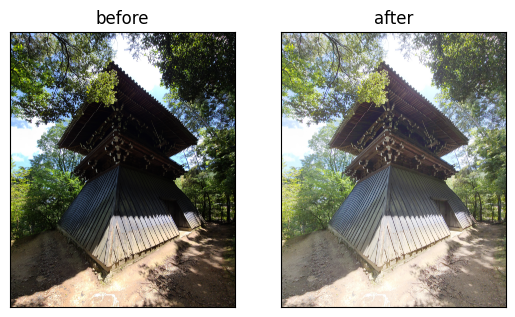

In [12]:
img = cv2.imread('color_temple.jpg')
img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
assert img is not None, "file could not be read, check with os.path.exists()"

# build a lookup table mapping the pixel values [0, 255] to
# their adjusted gamma values
gamma = 2.3
table = np.array([((i / 255.0) ** (1 / gamma)) * 255
    for i in np.arange(0, 256)]).astype("uint8")
# apply gamma correction using the lookup table
gc1 = cv2.LUT(img, table)

fig, axes = plt.subplots(1, 2)
axes[0].imshow(img,cmap='gray')
axes[0].set_title('before'), axes[0].set_xticks([]), axes[0].set_yticks([])
axes[1].imshow(gc1,cmap='gray')
axes[1].set_title('after'), axes[1].set_xticks([]), axes[1].set_yticks([]);

#### Color shift
Take an image of your choice and create two color-modified versions that are (a) more red; (b) less yellow. Show the original and two modified images and explain how you did it and what color space you've used. Note that you should not change the luminance of the photograph (i.e., don't make it more red just by increasing the values of the red channel). In OpenCv use cv2.cvtColor(image, cv2.COLOR_BGR2Lab) for converting between RGB and LAB spaces, in case you want to use LAB space.

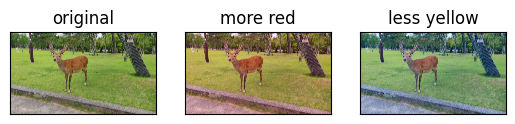

In [16]:
img = cv2.imread('deer.jpg', cv2.IMREAD_COLOR)
img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
assert img is not None, "file could not be read, check with os.path.exists()"

# more red
gamma = 1.2
table = np.array([((i / 255.0) ** (1.0 / gamma)) * 255
for i in np.arange(0, 256)]).astype("uint8")

lab1 = cv2.cvtColor(img, cv2.COLOR_RGB2Lab)
lab1[:,:,1] = cv2.LUT(lab1[:,:,1], table)
lab1 = cv2.cvtColor(lab1, cv2.COLOR_Lab2RGB)

# less yellow
gamma = 0.8
table = np.array([((i / 255.0) ** (1.0 / gamma)) * 255
for i in np.arange(0, 256)]).astype("uint8")

lab2 = cv2.cvtColor(img, cv2.COLOR_RGB2Lab)
lab2[:,:,2] = cv2.LUT(lab2[:,:,2], table)
lab2 = cv2.cvtColor(lab2, cv2.COLOR_Lab2RGB)


fig, axes = plt.subplots(1, 3)
axes[0].imshow(img,cmap='gray')
axes[0].set_title('original'), axes[0].set_xticks([]), axes[0].set_yticks([])
axes[1].imshow(lab1,cmap='gray')
axes[1].set_title('more red'), axes[1].set_xticks([]), axes[1].set_yticks([])
axes[2].imshow(lab2,cmap='gray')
axes[2].set_title('less yellow'), axes[2].set_xticks([]), axes[2].set_yticks([]);

### B&Ws
Try using color to enhance the effect of hybrid images. Does it work better to use color for the high-frequency component, the low-frequency component, or both? (5 pts)

In [444]:
im1_file = 'me.jpg'
im2_file = 'misha_small.jpg'

im1 = np.float32(cv2.imread(im1_file, cv2.IMREAD_GRAYSCALE) / 255.0)
im2 = np.float32(cv2.imread(im2_file, cv2.IMREAD_GRAYSCALE) / 255.0)

In [445]:
# pts_im1 = prompt_eye_selection(im1_gray)
pts_im1 = np.array([[451, 306], [552, 311]]) # uncomment if entering [x, y] pts manually
# plt.plot(pts_im1[:,0], pts_im1[:,1], 'r-+')

In [446]:
# pts_im2 = prompt_eye_selection(im2_gray)
pts_im2 = np.array([[646,751], [755,775]]) # uncomment if entering [x, y] pts manually
# plt.plot(pts_im2[:,0], pts_im2[:,1], 'r-+')

In [447]:
im1, im2 = align_images(im1_file, im2_file,pts_im1,pts_im2,save_images=False)

In [452]:
# convert to grayscale
im1 = cv2.cvtColor(im1, cv2.COLOR_BGR2RGB) / 255.0
im2 = cv2.cvtColor(im2, cv2.COLOR_BGR2RGB) / 255.0

In [465]:
# colored
low = cv2.GaussianBlur(im1,(21,21),0) 
high = im2 - cv2.GaussianBlur(im2,(21,21),80)

# trying to get three channel gray 
gray_low = cv2.cvtColor(low.astype('float32'), cv2.COLOR_RGB2GRAY)
gray_low = cv2.cvtColor(gray_low.astype('float32'), cv2.COLOR_GRAY2RGB)
gray_high = cv2.cvtColor(high.astype('float32'), cv2.COLOR_RGB2GRAY)
gray_high = cv2.cvtColor(gray_high.astype('float32'), cv2.COLOR_GRAY2RGB)

<IPython.core.display.Javascript object>


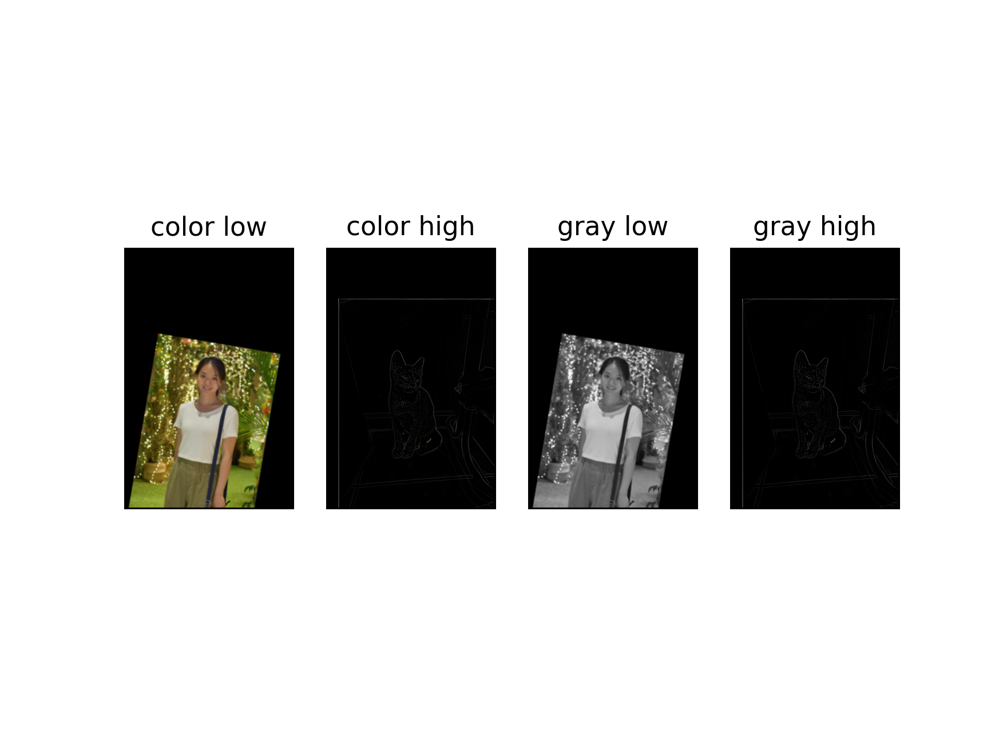

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


In [467]:
fig, axes = plt.subplots(1, 4)
axes[0].imshow(low,cmap='gray')
axes[0].set_title('color low'), axes[0].set_xticks([]), axes[0].set_yticks([])
axes[1].imshow(high,cmap='gray')
axes[1].set_title('color high'), axes[1].set_xticks([]), axes[1].set_yticks([])
axes[2].imshow(gray_low,cmap='gray')
axes[2].set_title('gray low'), axes[2].set_xticks([]), axes[2].set_yticks([])
axes[3].imshow(gray_high,cmap='gray')
axes[3].set_title('gray high'), axes[3].set_xticks([]), axes[3].set_yticks([]);

<IPython.core.display.Javascript object>


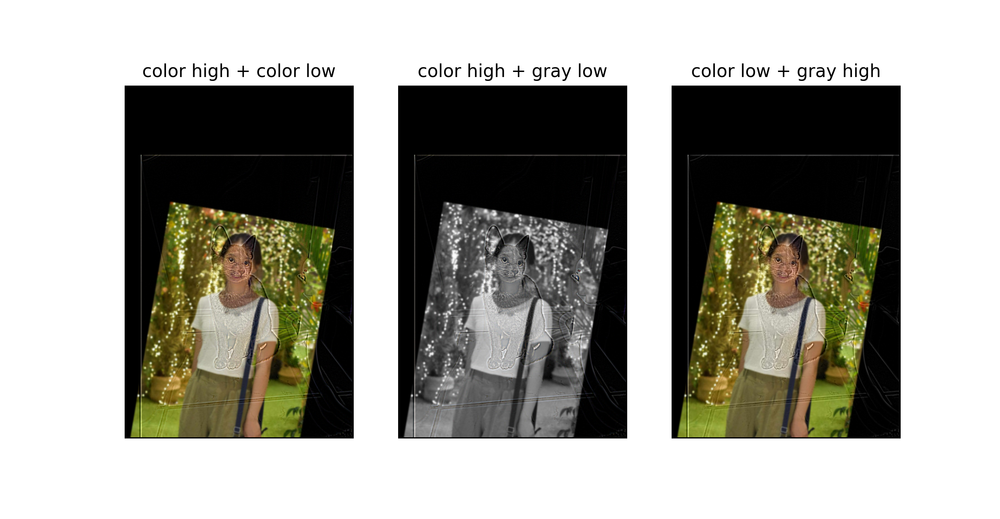

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


In [464]:
fig, axes = plt.subplots(1, 3)
axes[0].imshow(low + high,cmap='gray')
axes[0].set_title('color high + color low'), axes[0].set_xticks([]), axes[0].set_yticks([])
axes[1].imshow(gray_low + high,cmap='gray')
axes[1].set_title('color high + gray low'), axes[1].set_xticks([]), axes[1].set_yticks([])
axes[2].imshow(gray_high + low,cmap='gray')
axes[2].set_title('color low + gray high'), axes[2].set_xticks([]), axes[2].set_yticks([]);

Illustrate the hybrid image process by implementing Gaussian and Laplacian pyramids and displaying them for your favorite result. This should look similar to Figure 7 in the Oliva et al. paper. (15 pts)

In [91]:
# gaussian
layer = main_hybrid.copy()
gaussian_pyramid = [layer]
for i in range(4):
    layer = cv2.pyrDown(layer)
    gaussian_pyramid.append(layer)

# laplacian
layer = gaussian_pyramid[3]
laplacian_pyramid = [layer]
for i in range(4, 0, -1):
    size = (gaussian_pyramid[i - 1].shape[1], gaussian_pyramid[i - 1].shape[0])
    gaussian_expanded = cv2.pyrUp(gaussian_pyramid[i], dstsize=size)
    laplacian = cv2.subtract(gaussian_pyramid[i - 1], gaussian_expanded)
    laplacian_pyramid.append(laplacian)

<IPython.core.display.Javascript object>


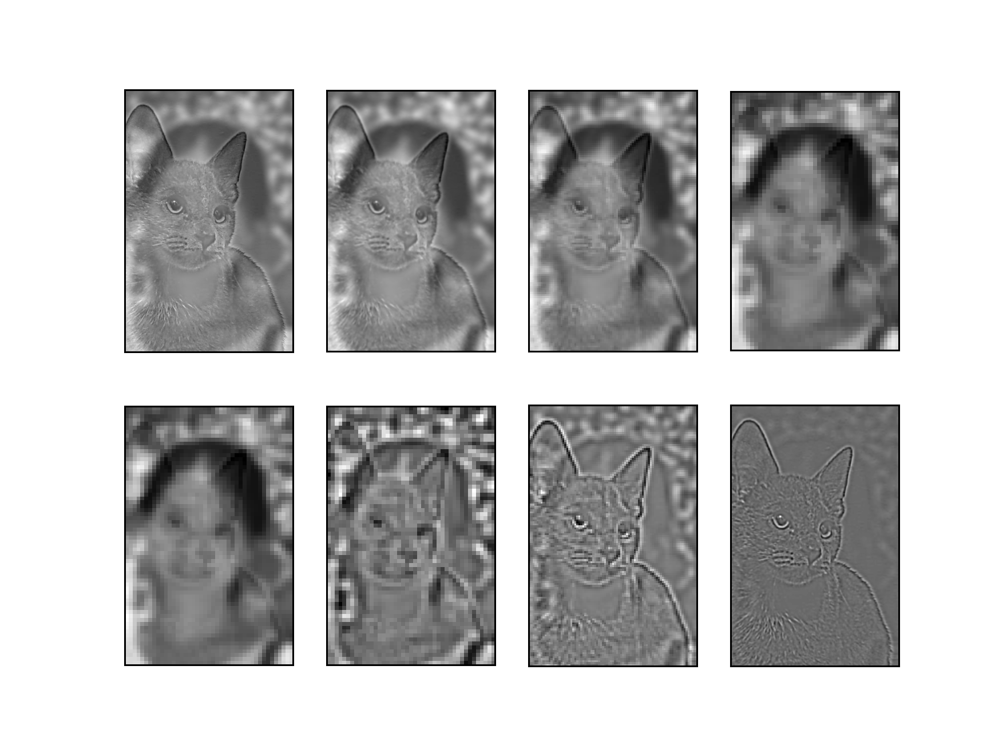

In [93]:
fig, axes = plt.subplots(2, 4)
axes[0, 0].imshow(gaussian_pyramid[0],cmap='gray')
axes[0, 0].set_xticks([]), axes[0, 0].set_yticks([])
axes[0, 1].imshow(gaussian_pyramid[1],cmap='gray')
axes[0, 1].set_xticks([]), axes[0, 1].set_yticks([])
axes[0, 2].imshow(gaussian_pyramid[2],cmap='gray')
axes[0, 2].set_xticks([]), axes[0, 2].set_yticks([])
axes[0, 3].imshow(gaussian_pyramid[3],cmap='gray')
axes[0, 3].set_xticks([]), axes[0, 3].set_yticks([])
axes[1, 0].imshow(laplacian_pyramid[0],cmap='gray')
axes[1, 0].set_xticks([]), axes[1, 0].set_yticks([])
axes[1, 1].imshow(laplacian_pyramid[1],cmap='gray')
axes[1, 1].set_xticks([]), axes[1, 1].set_yticks([])
axes[1, 2].imshow(laplacian_pyramid[2],cmap='gray')
axes[1, 2].set_xticks([]), axes[1, 2].set_yticks([])
axes[1, 3].imshow(laplacian_pyramid[3],cmap='gray')
axes[1, 3].set_xticks([]), axes[1, 3].set_yticks([]);